In [1]:
!pip install git+https://github.com/bshillingford/python-torchfile.git
!pip install torchmetrics

  Cloning https://github.com/bshillingford/python-torchfile.git to /tmp/pip-req-build-2f2v0zi2
  Running command git clone --filter=blob:none --quiet https://github.com/bshillingford/python-torchfile.git /tmp/pip-req-build-2f2v0zi2

  Resolved https://github.com/bshillingford/python-torchfile.git to commit fbd434a5b5562c88b91a95e6476e11dbb7735436
  Preparing metadata (setup.py) ... done


In [2]:
import torch
import numpy as np
import torchfile
import torchvision
import os
from scipy.io import loadmat
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import torch.nn.utils as utils
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import torchvision.models as models



In [3]:
PATH  = '/teamspace/studios/this_studio/'

In [4]:
labels = loadmat('imagelabels.mat')['labels'][0]
labels.shape

(8189,)

In [5]:
class ImageDataset(torch.utils.data.Dataset):
    def __init__(self, data_path, caption_path, labels):
        self.images = []
        self.embed_finder = []
        self.text_embeddings = []
        self.image_path = data_path
        self.embed_path = caption_path
        self.labels = labels.tolist()
        self.trans = transforms.Compose([
            transforms.Resize((64, 64)),
            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
        ])
        
        for i in os.listdir(self.image_path):
            self.images.append(os.path.join(self.image_path, i))
            temp = i.split('.')[0]
            self.embed_finder.append(temp)

        for idx, (image_name, label) in enumerate(zip(self.embed_finder, self.labels)):
            embed_file = os.path.join(self.embed_path, str(label), f"{image_name}.t7")
            embed = torchfile.load(embed_file, force_8bytes_long=True)
            
            txt_embeddings = embed[b'txt']
            
            self.text_embeddings.append(txt_embeddings)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        image_path = self.images[idx]
        image = torchvision.io.read_image(image_path).float() / 255.0
        image = self.trans(image)
        label = self.labels[idx]
        text_embedding = self.text_embeddings[idx]
        
        return image, text_embedding, int(label)
    
dataset = ImageDataset(PATH + "102flowers/jpg", PATH + "caption_data", labels)



In [6]:
np.random.seed(16)
torch.manual_seed(16)

unique_classes = np.unique(labels)

train_classes = np.random.choice(unique_classes, size=20, replace=False)
remaining_classes = np.setdiff1d(unique_classes, train_classes)
test_classes = np.random.choice(remaining_classes, size=5, replace=False)

train_mask = np.isin(labels, train_classes)
test_mask = np.isin(labels, test_classes)

train_indices = np.where(train_mask)[0]
test_indices = np.where(test_mask)[0]

train_dataset = torch.utils.data.Subset(dataset, train_indices)
test_dataset = torch.utils.data.Subset(dataset, test_indices)

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=32, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=32, shuffle=False)


In [7]:
class PerceptualLoss(nn.Module):
    def __init__(self):
        super().__init__()
        vgg = models.vgg16(pretrained=True).eval()
        self.features = nn.ModuleList([
            vgg.features[:4],   
            vgg.features[:9],   
            vgg.features[:16], 
        ]).eval()
        
        for param in self.parameters():
            param.requires_grad = False
            
    def forward(self, x, y):
        loss = 0.0
        for feature_extractor in self.features:
            x_feat = feature_extractor(x)
            y_feat = feature_extractor(y)
            loss += torch.nn.functional.l1_loss(x_feat, y_feat)
        return loss

class SourceEncoder(nn.Module):
    def __init__(self, out_dim=256):
        super(SourceEncoder, self).__init__()
        
        self.conv1 = nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1) 
        self.bn1 = nn.BatchNorm2d(32)
        
        self.conv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)  
        self.bn2 = nn.BatchNorm2d(64)
        
        self.conv3 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1) 
        self.bn3 = nn.BatchNorm2d(128)

        self.conv4 = nn.Conv2d(128, 256, 4, 2, 1) 
        self.bn4 = nn.BatchNorm2d(256)
        
        self.fc = nn.Linear(256 * 4 * 4, out_dim)
        
        self.leakyrelu = nn.LeakyReLU(0.2)

    def forward(self, x):
        x = self.leakyrelu(self.bn1(self.conv1(x)))   
        x = self.leakyrelu(self.bn2(self.conv2(x)))   
        x = self.leakyrelu(self.bn3(self.conv3(x)))   
        x = self.leakyrelu(self.bn4(self.conv4(x)))   
        
        x = x.view(x.size(0), -1)  
        x = self.fc(x)             
        return x

    def count_parameters(self):
        return sum(p.numel() for p in self.parameters() if p.requires_grad)

class TextEncoder(nn.Module):
    def __init__(self, text_embedding_dim=1024, out_dim=256):
        super(TextEncoder, self).__init__()
        self.fc = nn.Linear(text_embedding_dim, out_dim)
        self.leakyrelu = nn.LeakyReLU(0.2)

    def forward(self, x):
        x = self.fc(x)
        x = self.leakyrelu(x)
        return x

class Discriminator(nn.Module):
    def __init__(self,text_embedding_dim=1024):
        super(Discriminator, self).__init__()
        
        self.conv1 = utils.spectral_norm(
            nn.Conv2d(3, 16, kernel_size=4, stride=2, padding=1)
        )
        
        self.conv2 = utils.spectral_norm(
            nn.Conv2d(16, 32, kernel_size=4, stride=2, padding=1)
        )
        self.bn2 = nn.BatchNorm2d(32)
        
        self.conv3 = utils.spectral_norm(
            nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)
        )
        self.bn3 = nn.BatchNorm2d(64)

        self.conv4 = utils.spectral_norm(
            nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        )
        self.bn4 = nn.BatchNorm2d(128)
        
        self.fc = utils.spectral_norm(
            nn.Linear(128 * 4 * 4 + text_embedding_dim, 1)
        )
        self.leakyrelu = nn.LeakyReLU(0.2)
    
    def forward(self, image, text_embedding):
        x = self.leakyrelu(self.conv1(image))  
        
        x = self.leakyrelu(self.bn2(self.conv2(x)))  
        # print("After conv2:", x.shape)
        
        x = self.leakyrelu(self.bn3(self.conv3(x)))  
        # print("After conv3:", x.shape)
        
        x = self.leakyrelu(self.bn4(self.conv4(x)))  
        # print("After conv4:", x.shape)
        
        x = x.view(x.size(0), -1)
        # print("Flattened:", x.shape)
        
        x = torch.cat([x, text_embedding], dim=1)
        # print("After concatenation:", x.shape)
        
        x = self.fc(x)
        return x
    
    def count_parameters(self):
        return sum(p.numel() for p in self.parameters() if p.requires_grad)


class TargetGenerator(nn.Module):
    def __init__(self, text_embedding_dim=1024, latent_dim=100, out_dim=256):
        super().__init__()
        
        self.initial = nn.Sequential(
            nn.Linear(out_dim + out_dim, 4 * 4 * 512),
            nn.LeakyReLU(0.2),
            nn.Unflatten(1, (512, 4, 4))  
        )
        
        self.up1 = nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1)  # 8x8
        self.bn1 = nn.BatchNorm2d(256)
        
        self.up2 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)  # 16x16
        self.bn2 = nn.BatchNorm2d(128)
        
        self.up3 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)  # 32x32
        self.bn3 = nn.BatchNorm2d(64)
        
        self.up4 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)  # 64x64
        self.bn4 = nn.BatchNorm2d(32)
        
        self.lateral1 = nn.Conv2d(512, 256, kernel_size=1)
        self.lateral2 = nn.Conv2d(256, 128, kernel_size=1)
        self.lateral3 = nn.Conv2d(128, 64, kernel_size=1)
        self.lateral4 = nn.Conv2d(64, 32, kernel_size=1)  
        
        self.refine1 = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.refine2 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.refine3 = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.refine4 = nn.Conv2d(32, 32, kernel_size=3, padding=1) 
        
        self.leakyrelu = nn.LeakyReLU(0.2)
        
        self.final = nn.Sequential(
            nn.Conv2d(32, 3, kernel_size=3, padding=1),
            nn.Tanh()
        )
    
    def forward(self, source_representation, text_encoding):
        x = torch.cat([source_representation, text_encoding], dim=1)
        x = self.initial(x)  # 4x4
        feat1 = x
        
        x = self.up1(x)
        x = self.bn1(x)
        lateral1 = F.interpolate(self.lateral1(feat1), scale_factor=2, mode='nearest')
        x = x + lateral1
        x = self.leakyrelu(self.refine1(x))
        feat2 = x
        
        x = self.up2(x)
        x = self.bn2(x)
        lateral2 = F.interpolate(self.lateral2(feat2), scale_factor=2, mode='nearest')
        x = x + lateral2
        x = self.leakyrelu(self.refine2(x))
        feat3 = x
        
        x = self.up3(x)
        x = self.bn3(x)
        lateral3 = F.interpolate(self.lateral3(feat3), scale_factor=2, mode='nearest')
        x = x + lateral3
        x = self.leakyrelu(self.refine3(x))
        feat4 = x
        
        x = self.up4(x)
        x = self.bn4(x)
        lateral4 = F.interpolate(self.lateral4(feat4), scale_factor=2, mode='nearest')
        x = x + lateral4
        x = self.leakyrelu(self.refine4(x))
        
        return self.final(x)  
    
    def count_parameters(self):
        return sum(p.numel() for p in self.parameters() if p.requires_grad)


1739936
7948483


Epoch 1:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [1/200] D_loss: 6.7304 G_loss: 2.9133


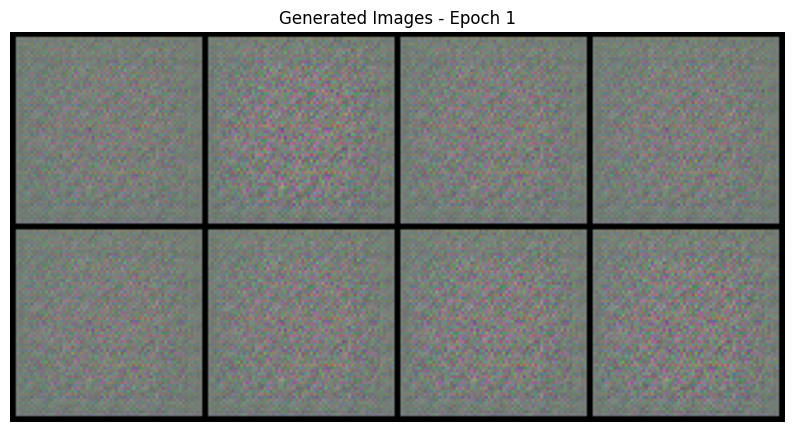

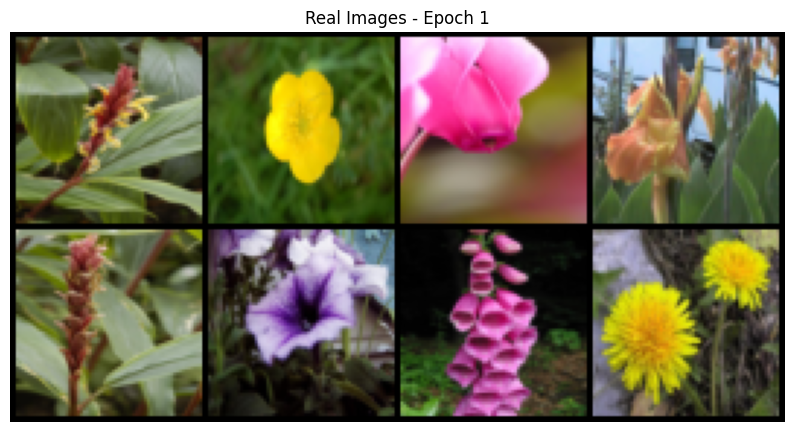

Epoch 2:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [2/200] D_loss: 4.5669 G_loss: 2.8864


Epoch 3:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [3/200] D_loss: 4.1412 G_loss: 2.9995


Epoch 4:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [4/200] D_loss: 3.5845 G_loss: 3.0838


Epoch 5:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [5/200] D_loss: 3.3391 G_loss: 3.1030


Epoch 6:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [6/200] D_loss: 2.9308 G_loss: 3.1852


Epoch 7:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [7/200] D_loss: 2.6081 G_loss: 3.2733


Epoch 8:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [8/200] D_loss: 2.4333 G_loss: 3.2740


Epoch 9:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [9/200] D_loss: 2.2368 G_loss: 3.3002


Epoch 10:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [10/200] D_loss: 2.1030 G_loss: 3.3762


Epoch 11:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [11/200] D_loss: 2.1762 G_loss: 3.3850


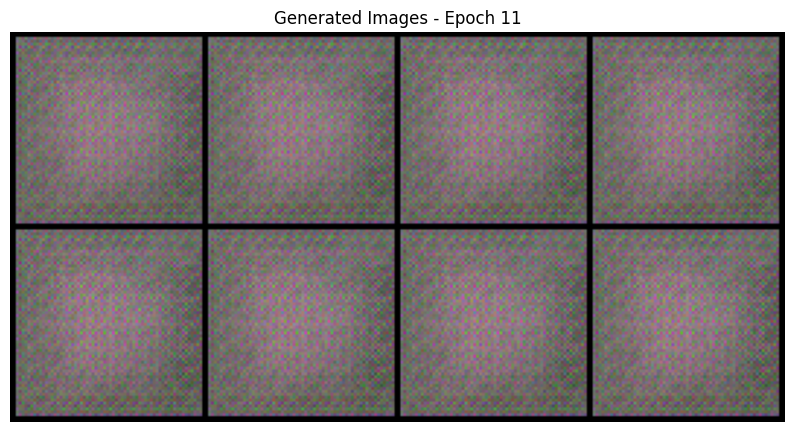

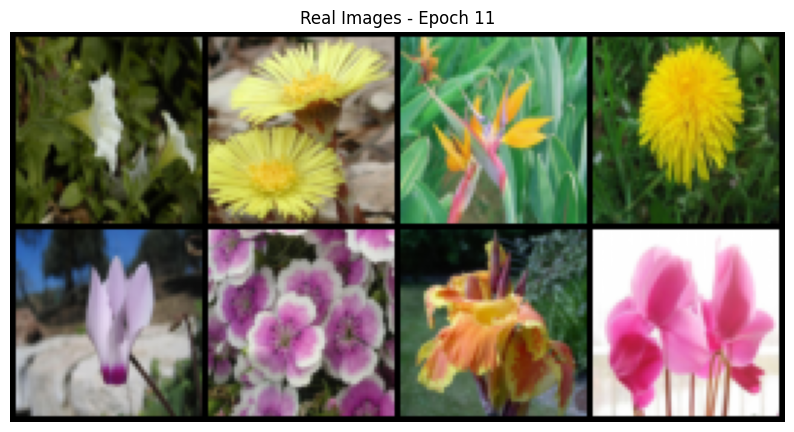

Epoch 12:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [12/200] D_loss: 2.0551 G_loss: 3.4047


Epoch 13:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [13/200] D_loss: 2.0560 G_loss: 3.4517


Epoch 14:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [14/200] D_loss: 2.1119 G_loss: 3.4727


Epoch 15:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [15/200] D_loss: 2.1756 G_loss: 3.5117


Epoch 16:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [16/200] D_loss: 2.0865 G_loss: 3.5644


Epoch 17:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [17/200] D_loss: 2.2716 G_loss: 3.6347


Epoch 18:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [18/200] D_loss: 2.1254 G_loss: 3.7300


Epoch 19:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [19/200] D_loss: 2.1619 G_loss: 3.8752


Epoch 20:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [20/200] D_loss: 2.1560 G_loss: 3.8872


Epoch 21:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [21/200] D_loss: 2.0514 G_loss: 4.0744


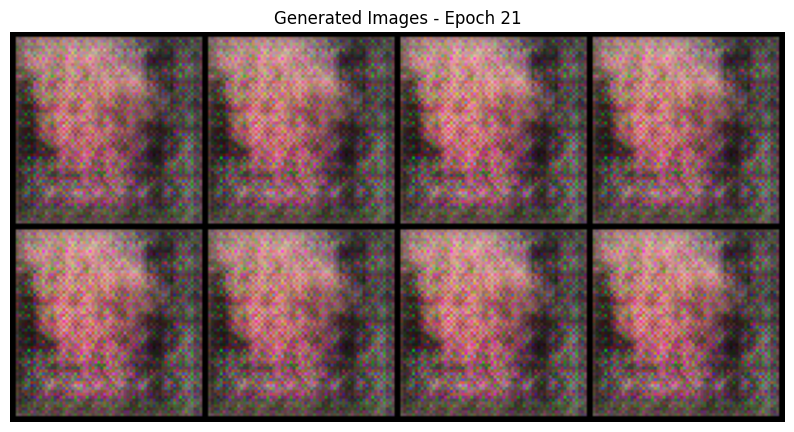

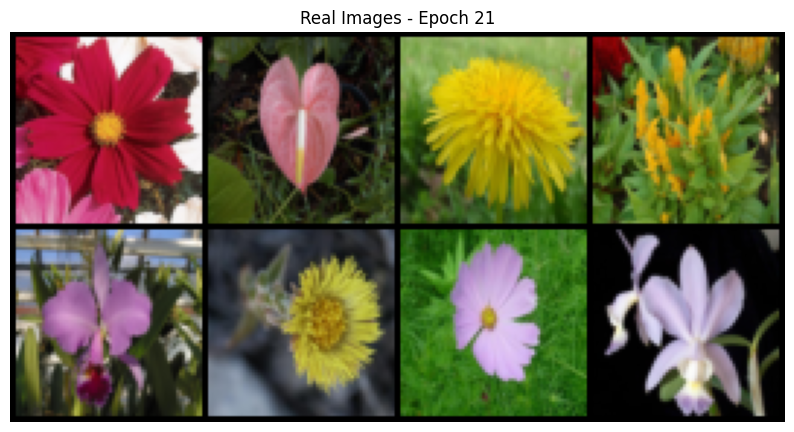

Epoch 22:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [22/200] D_loss: 2.5517 G_loss: 3.7066


Epoch 23:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [23/200] D_loss: 2.7263 G_loss: 3.4857


Epoch 24:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [24/200] D_loss: 2.2707 G_loss: 3.9128


Epoch 25:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [25/200] D_loss: 1.2064 G_loss: 4.9534


Epoch 26:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [26/200] D_loss: 2.2760 G_loss: 4.1283


Epoch 27:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [27/200] D_loss: 2.4141 G_loss: 3.9079


Epoch 28:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [28/200] D_loss: 2.3124 G_loss: 3.8751


Epoch 29:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [29/200] D_loss: 2.1650 G_loss: 3.9969


Epoch 30:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [30/200] D_loss: 2.1079 G_loss: 3.8572


Epoch 31:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [31/200] D_loss: 2.2517 G_loss: 3.7099


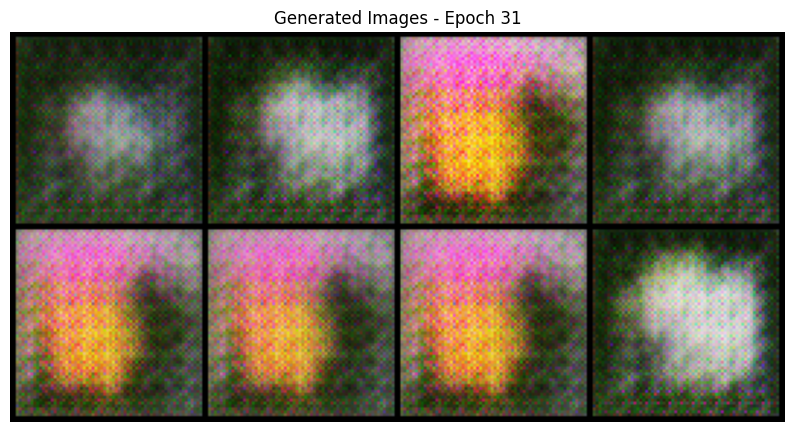

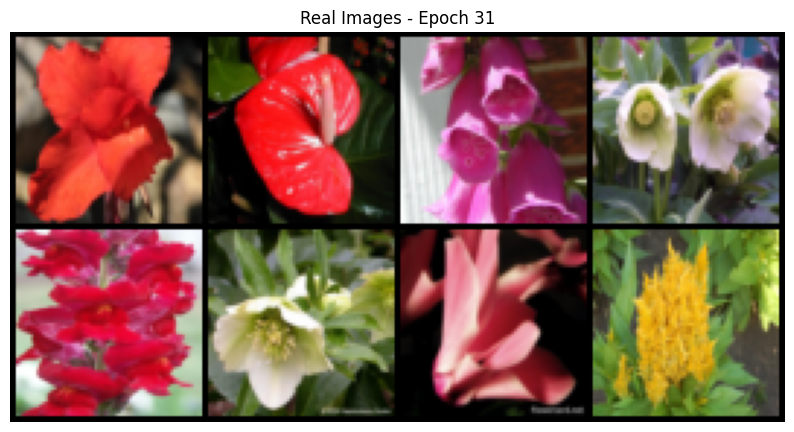

Epoch 32:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [32/200] D_loss: 2.0366 G_loss: 3.9051


Epoch 33:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [33/200] D_loss: 2.1276 G_loss: 3.8495


Epoch 34:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [34/200] D_loss: 2.1592 G_loss: 3.8245


Epoch 35:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [35/200] D_loss: 2.0601 G_loss: 3.7713


Epoch 36:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [36/200] D_loss: 2.1383 G_loss: 3.8164


Epoch 37:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [37/200] D_loss: 2.1356 G_loss: 3.7547


Epoch 38:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [38/200] D_loss: 2.1390 G_loss: 3.7874


Epoch 39:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [39/200] D_loss: 1.9980 G_loss: 3.8065


Epoch 40:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [40/200] D_loss: 1.9530 G_loss: 3.7991


Epoch 41:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [41/200] D_loss: 1.9182 G_loss: 3.7448


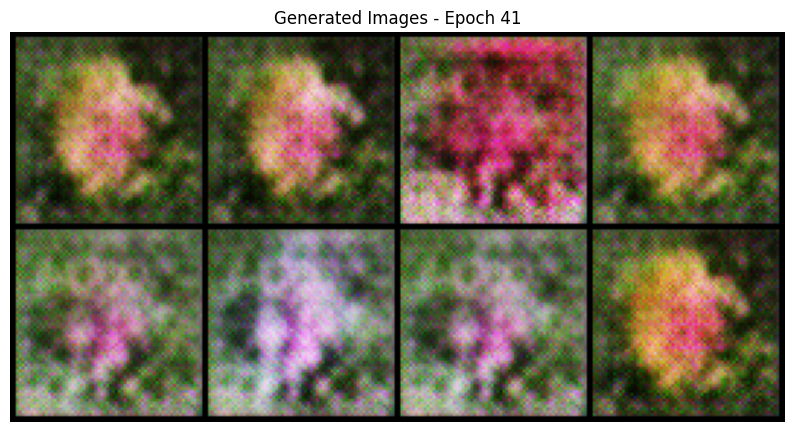

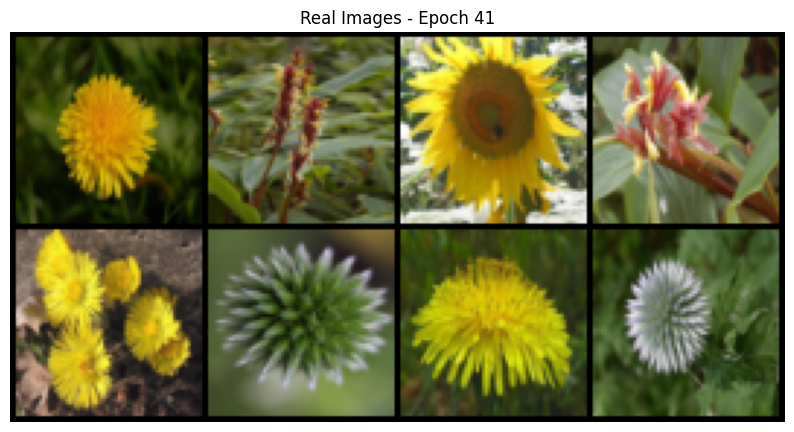

Epoch 42:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [42/200] D_loss: 1.9626 G_loss: 3.7842


Epoch 43:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [43/200] D_loss: 1.9539 G_loss: 3.8298


Epoch 44:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [44/200] D_loss: 1.9059 G_loss: 3.9943


Epoch 45:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [45/200] D_loss: 1.8904 G_loss: 3.9842


Epoch 46:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [46/200] D_loss: 1.8065 G_loss: 3.8465


Epoch 47:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [47/200] D_loss: 1.8797 G_loss: 3.8544


Epoch 48:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [48/200] D_loss: 1.7994 G_loss: 3.8137


Epoch 49:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [49/200] D_loss: 1.8234 G_loss: 3.8802


Epoch 50:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [50/200] D_loss: 1.7727 G_loss: 3.8571


Epoch 51:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [51/200] D_loss: 1.8112 G_loss: 3.9621


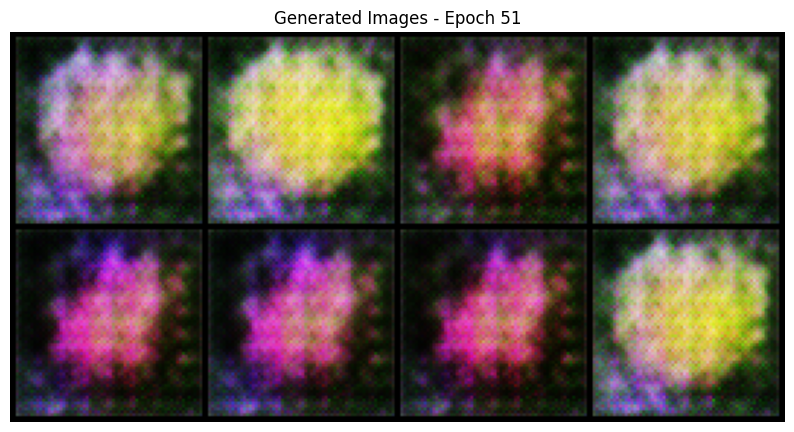

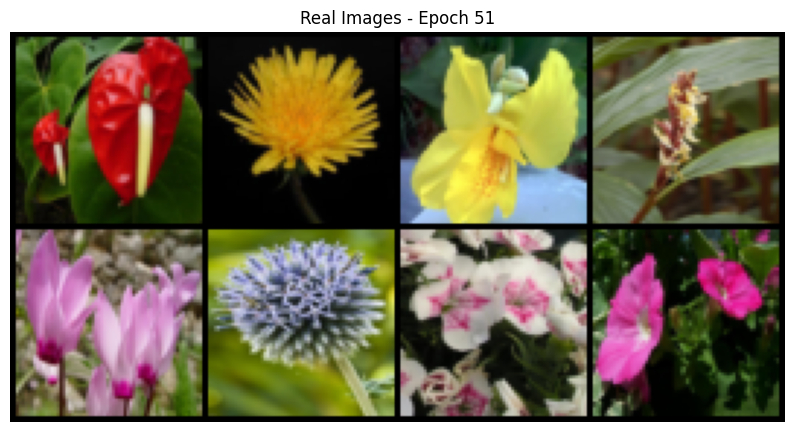

Epoch 52:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [52/200] D_loss: 1.7317 G_loss: 4.0284


Epoch 53:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [53/200] D_loss: 1.7187 G_loss: 3.9482


Epoch 54:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [54/200] D_loss: 1.7505 G_loss: 3.9646


Epoch 55:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [55/200] D_loss: 1.7609 G_loss: 3.8994


Epoch 56:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [56/200] D_loss: 1.7725 G_loss: 3.9058


Epoch 57:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [57/200] D_loss: 1.7076 G_loss: 3.9612


Epoch 58:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [58/200] D_loss: 1.6896 G_loss: 3.8731


Epoch 59:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [59/200] D_loss: 1.7156 G_loss: 3.8718


Epoch 60:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [60/200] D_loss: 1.7243 G_loss: 3.8613


Epoch 61:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [61/200] D_loss: 1.6694 G_loss: 3.8689


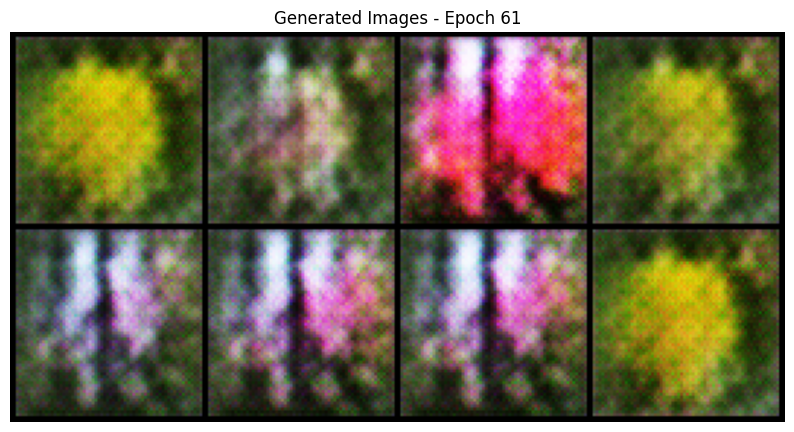

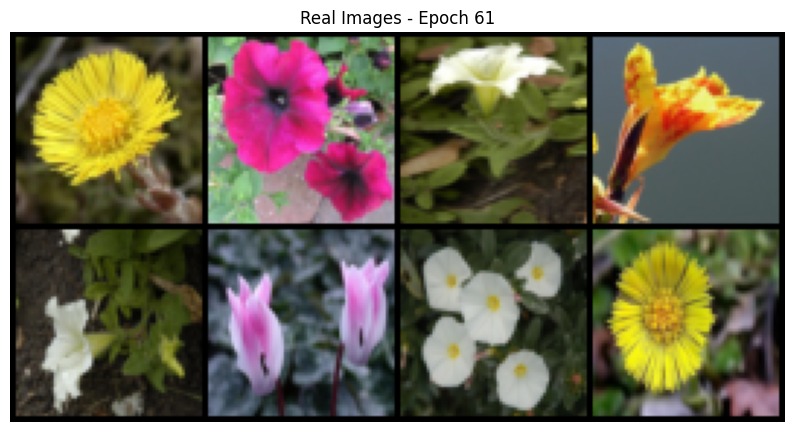

Epoch 62:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [62/200] D_loss: 1.7296 G_loss: 3.9214


Epoch 63:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [63/200] D_loss: 1.7463 G_loss: 3.9725


Epoch 64:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [64/200] D_loss: 1.6854 G_loss: 3.9641


Epoch 65:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [65/200] D_loss: 1.5708 G_loss: 3.8525


Epoch 66:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [66/200] D_loss: 1.6737 G_loss: 3.8719


Epoch 67:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [67/200] D_loss: 1.6726 G_loss: 3.8903


Epoch 68:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [68/200] D_loss: 1.7155 G_loss: 3.8871


Epoch 69:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [69/200] D_loss: 1.6752 G_loss: 3.9148


Epoch 70:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [70/200] D_loss: 1.6637 G_loss: 3.8761


Epoch 71:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [71/200] D_loss: 1.6462 G_loss: 3.8576


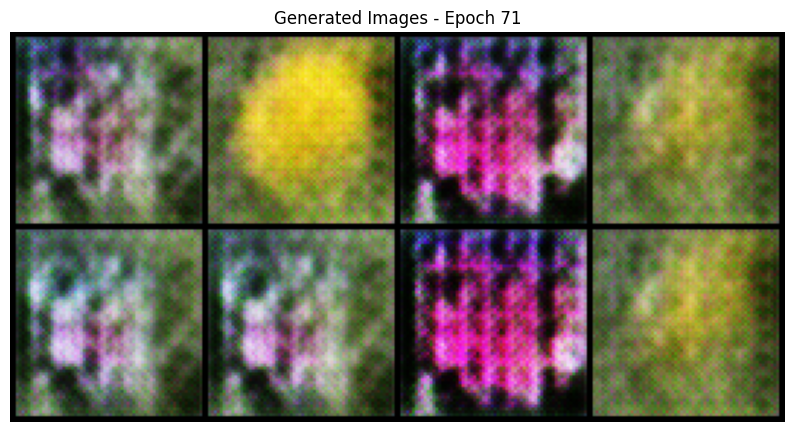

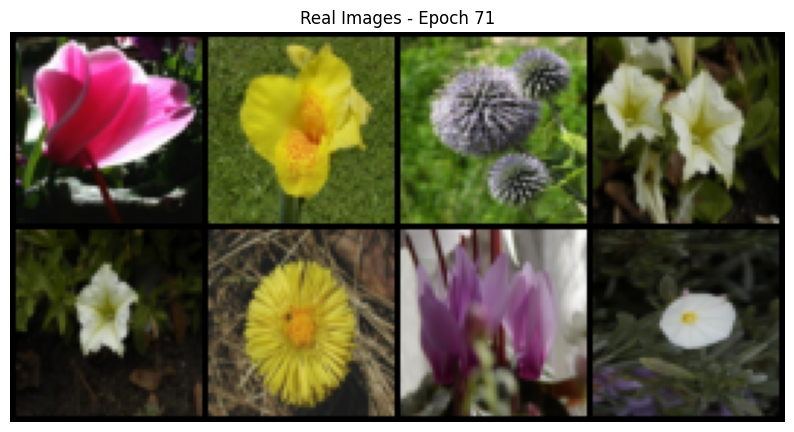

Epoch 72:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [72/200] D_loss: 1.6914 G_loss: 3.8753


Epoch 73:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [73/200] D_loss: 1.6367 G_loss: 3.8591


Epoch 74:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [74/200] D_loss: 1.6710 G_loss: 3.9172


Epoch 75:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [75/200] D_loss: 1.7100 G_loss: 3.8620


Epoch 76:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [76/200] D_loss: 1.6572 G_loss: 3.8994


Epoch 77:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [77/200] D_loss: 1.6661 G_loss: 3.8520


Epoch 78:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [78/200] D_loss: 1.6041 G_loss: 3.9326


Epoch 79:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [79/200] D_loss: 1.6017 G_loss: 3.8930


Epoch 80:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [80/200] D_loss: 1.6537 G_loss: 3.9254


Epoch 81:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [81/200] D_loss: 1.6261 G_loss: 3.8425


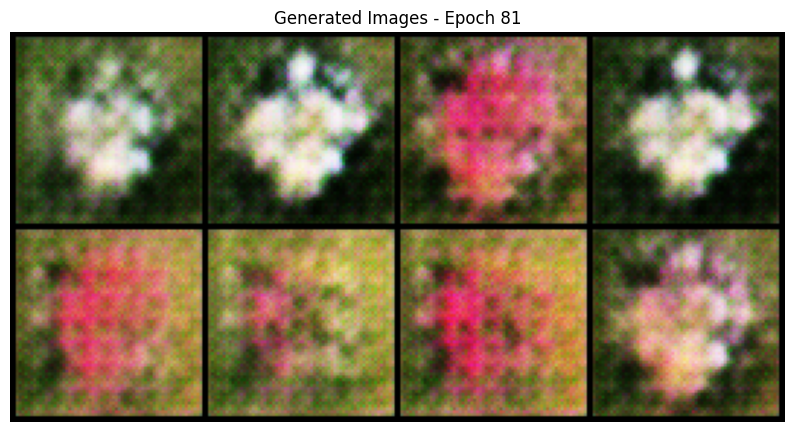

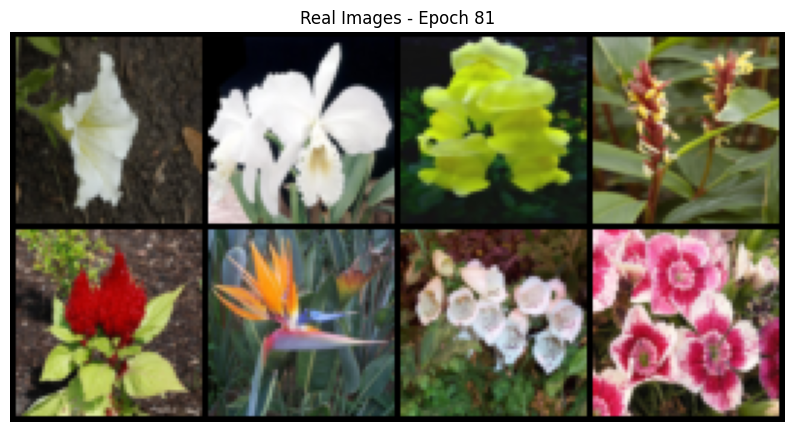

Epoch 82:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [82/200] D_loss: 1.5874 G_loss: 3.9031


Epoch 83:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [83/200] D_loss: 1.6336 G_loss: 3.8708


Epoch 84:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [84/200] D_loss: 1.6989 G_loss: 3.8897


Epoch 85:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [85/200] D_loss: 1.5916 G_loss: 3.8480


Epoch 86:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [86/200] D_loss: 1.6414 G_loss: 3.9057


Epoch 87:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [87/200] D_loss: 1.6108 G_loss: 3.8166


Epoch 88:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [88/200] D_loss: 1.6192 G_loss: 3.8040


Epoch 89:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [89/200] D_loss: 1.6202 G_loss: 3.8325


Epoch 90:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [90/200] D_loss: 1.5962 G_loss: 3.7974


Epoch 91:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [91/200] D_loss: 1.5887 G_loss: 3.7512


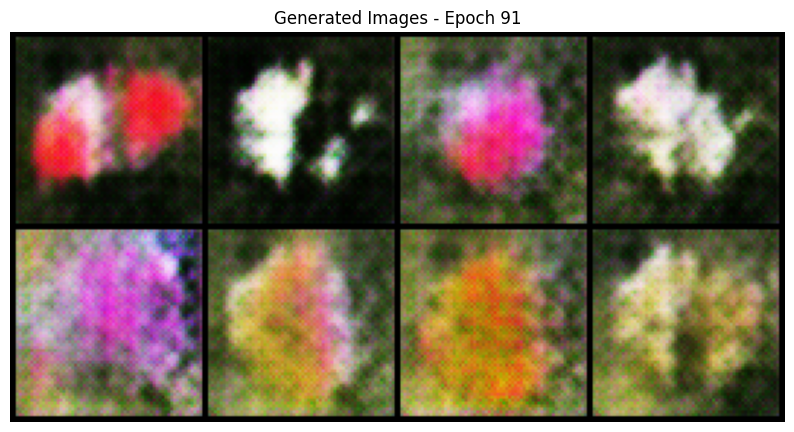

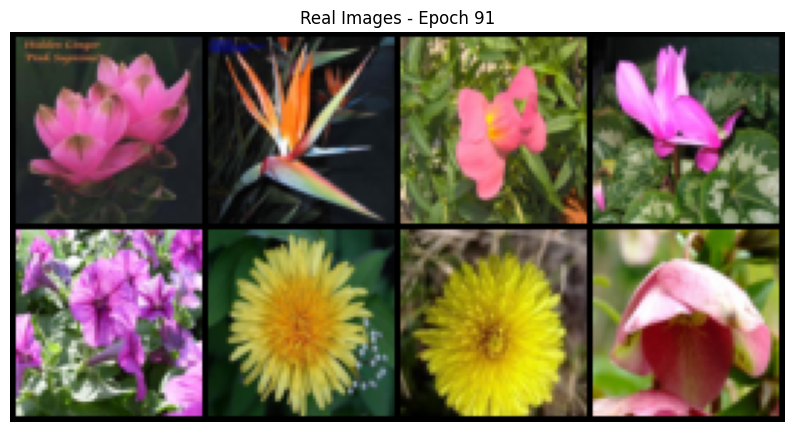

Epoch 92:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [92/200] D_loss: 1.6443 G_loss: 3.7362


Epoch 93:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [93/200] D_loss: 1.6705 G_loss: 3.6986


Epoch 94:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [94/200] D_loss: 1.6193 G_loss: 3.6624


Epoch 95:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [95/200] D_loss: 1.6129 G_loss: 3.6394


Epoch 96:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [96/200] D_loss: 1.6239 G_loss: 3.6176


Epoch 97:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [97/200] D_loss: 1.6561 G_loss: 3.6029


Epoch 98:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [98/200] D_loss: 1.6178 G_loss: 3.5812


Epoch 99:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [99/200] D_loss: 1.6273 G_loss: 3.5534


Epoch 100:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [100/200] D_loss: 1.6353 G_loss: 3.5452


Epoch 101:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [101/200] D_loss: 1.6328 G_loss: 3.5247


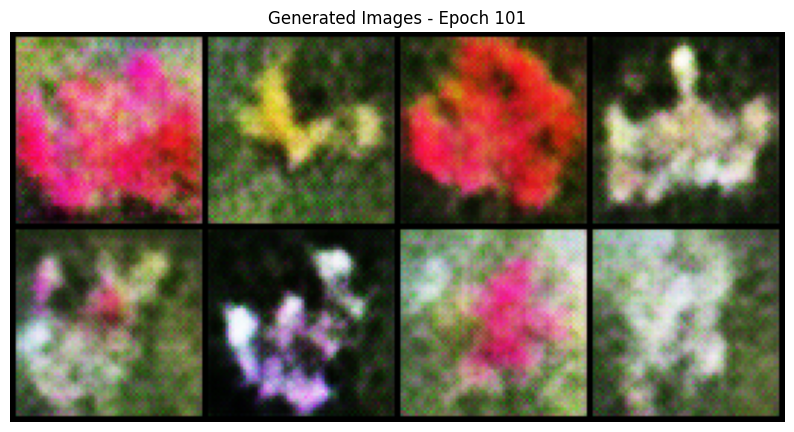

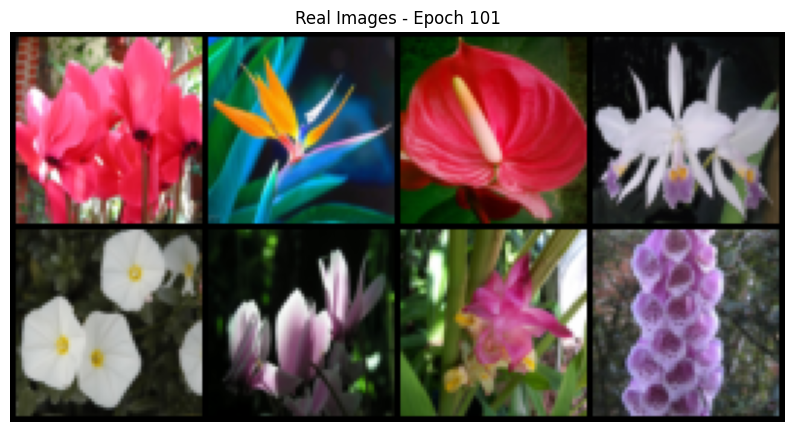

Epoch 102:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [102/200] D_loss: 1.6416 G_loss: 3.5052


Epoch 103:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [103/200] D_loss: 1.6589 G_loss: 3.4873


Epoch 104:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [104/200] D_loss: 1.6286 G_loss: 3.4711


Epoch 105:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [105/200] D_loss: 1.6133 G_loss: 3.4538


Epoch 106:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [106/200] D_loss: 1.6167 G_loss: 3.4367


Epoch 107:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [107/200] D_loss: 1.6105 G_loss: 3.4123


Epoch 108:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [108/200] D_loss: 1.6199 G_loss: 3.3966


Epoch 109:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [109/200] D_loss: 1.6441 G_loss: 3.3726


Epoch 110:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [110/200] D_loss: 1.6340 G_loss: 3.3536


Epoch 111:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [111/200] D_loss: 1.5845 G_loss: 3.3325


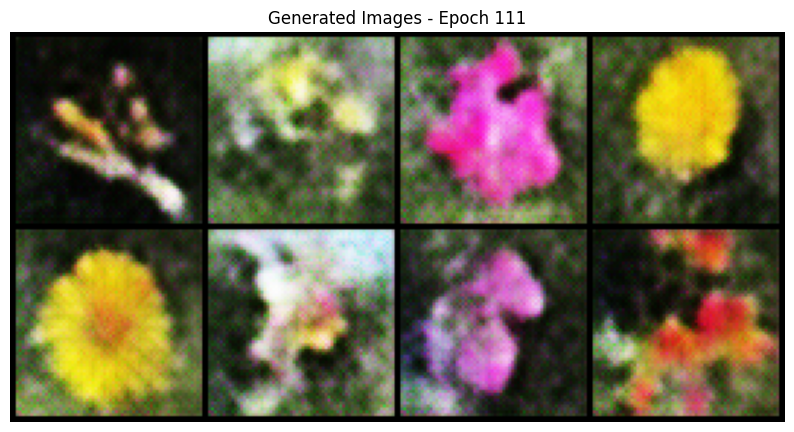

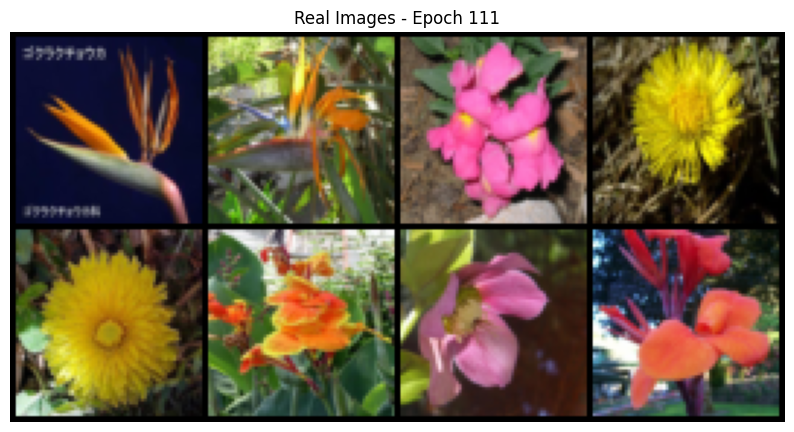

Epoch 112:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [112/200] D_loss: 1.5557 G_loss: 3.3157


Epoch 113:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [113/200] D_loss: 1.5478 G_loss: 3.3002


Epoch 114:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [114/200] D_loss: 1.5873 G_loss: 3.2810


Epoch 115:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [115/200] D_loss: 1.5504 G_loss: 3.2668


Epoch 116:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [116/200] D_loss: 1.5505 G_loss: 3.2412


Epoch 117:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [117/200] D_loss: 1.5314 G_loss: 3.2198


Epoch 118:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [118/200] D_loss: 1.5267 G_loss: 3.1942


Epoch 119:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [119/200] D_loss: 1.5506 G_loss: 3.1823


Epoch 120:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [120/200] D_loss: 1.5230 G_loss: 3.1599


Epoch 121:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [121/200] D_loss: 1.5198 G_loss: 3.1358


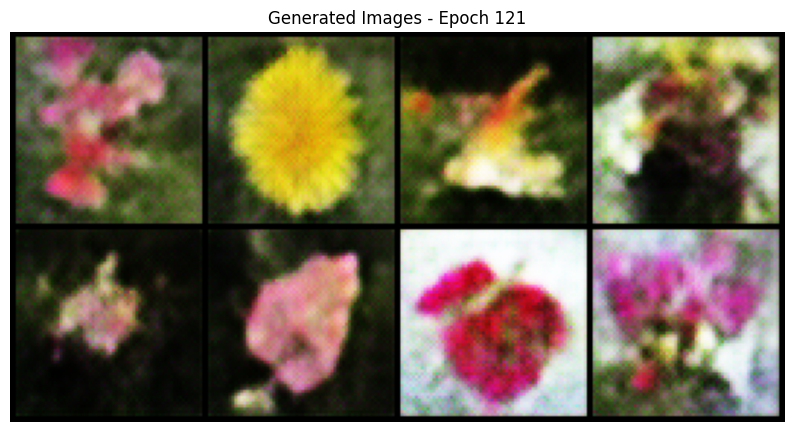

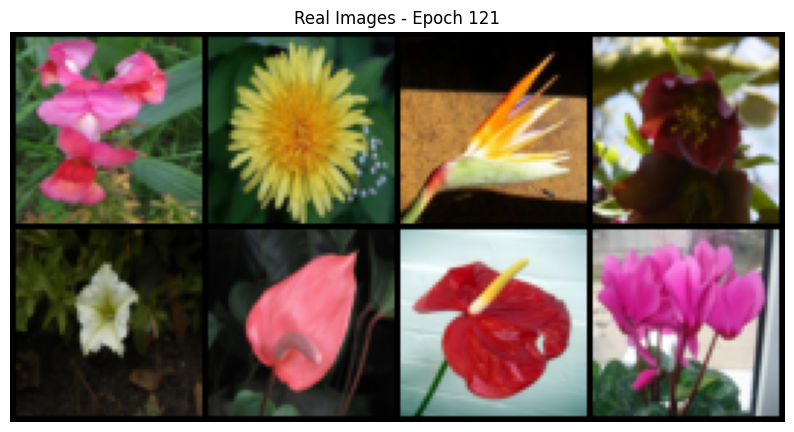

Epoch 122:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [122/200] D_loss: 1.5173 G_loss: 3.1142


Epoch 123:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [123/200] D_loss: 1.5194 G_loss: 3.0813


Epoch 124:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [124/200] D_loss: 1.5210 G_loss: 3.0637


Epoch 125:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [125/200] D_loss: 1.5111 G_loss: 3.0440


Epoch 126:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [126/200] D_loss: 1.5028 G_loss: 3.0232


Epoch 127:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [127/200] D_loss: 1.5017 G_loss: 3.0121


Epoch 128:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [128/200] D_loss: 1.4995 G_loss: 2.9906


Epoch 129:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [129/200] D_loss: 1.5030 G_loss: 2.9735


Epoch 130:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [130/200] D_loss: 1.4986 G_loss: 2.9482


Epoch 131:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [131/200] D_loss: 1.5086 G_loss: 2.9280


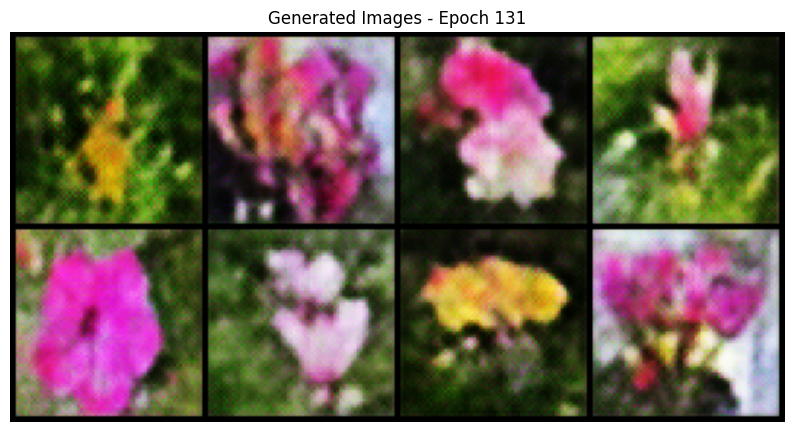

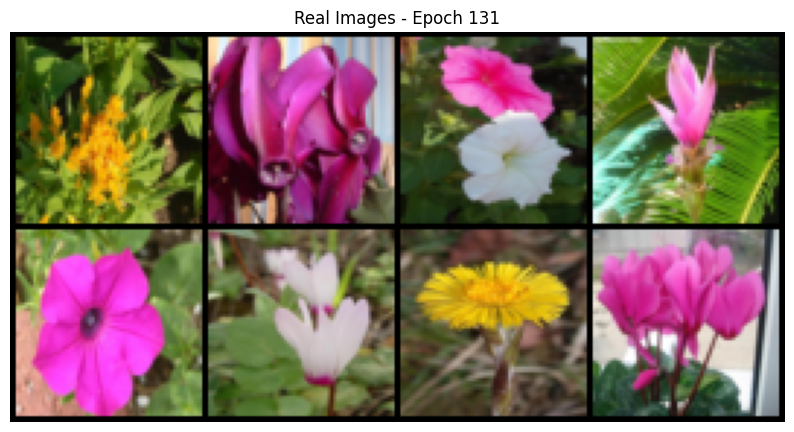

Epoch 132:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [132/200] D_loss: 1.5063 G_loss: 2.9122


Epoch 133:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [133/200] D_loss: 1.4980 G_loss: 2.8872


Epoch 134:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [134/200] D_loss: 1.4991 G_loss: 2.8759


Epoch 135:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [135/200] D_loss: 1.4924 G_loss: 2.8515


Epoch 136:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [136/200] D_loss: 1.4910 G_loss: 2.8354


Epoch 137:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [137/200] D_loss: 1.4909 G_loss: 2.8273


Epoch 138:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [138/200] D_loss: 1.4754 G_loss: 2.8100


Epoch 139:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [139/200] D_loss: 1.4759 G_loss: 2.7906


Epoch 140:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [140/200] D_loss: 1.4836 G_loss: 2.7874


Epoch 141:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [141/200] D_loss: 1.4795 G_loss: 2.7713


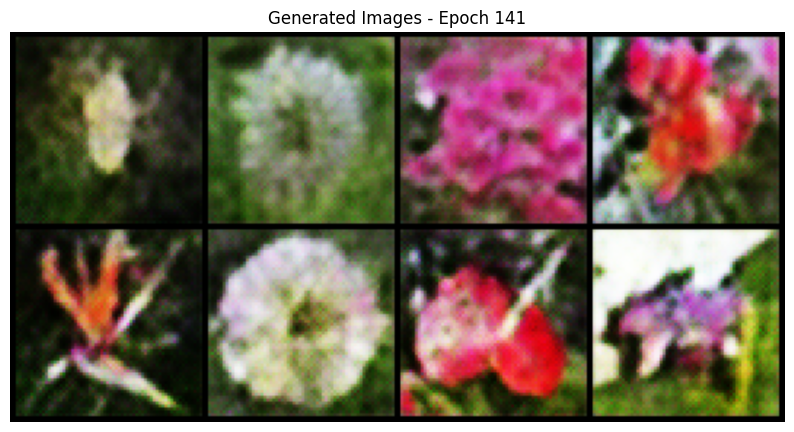

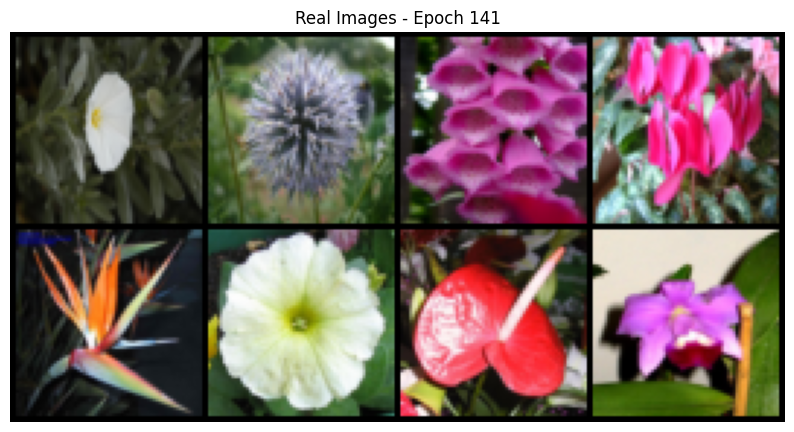

Epoch 142:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [142/200] D_loss: 1.4710 G_loss: 2.7470


Epoch 143:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [143/200] D_loss: 1.4719 G_loss: 2.7319


Epoch 144:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [144/200] D_loss: 1.4684 G_loss: 2.7190


Epoch 145:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [145/200] D_loss: 1.4660 G_loss: 2.7195


Epoch 146:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [146/200] D_loss: 1.4656 G_loss: 2.6969


Epoch 147:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [147/200] D_loss: 1.4627 G_loss: 2.6780


Epoch 148:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [148/200] D_loss: 1.4561 G_loss: 2.6807


Epoch 149:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [149/200] D_loss: 1.4598 G_loss: 2.6658


Epoch 150:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [150/200] D_loss: 1.4543 G_loss: 2.6533


Epoch 151:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [151/200] D_loss: 1.4515 G_loss: 2.6433


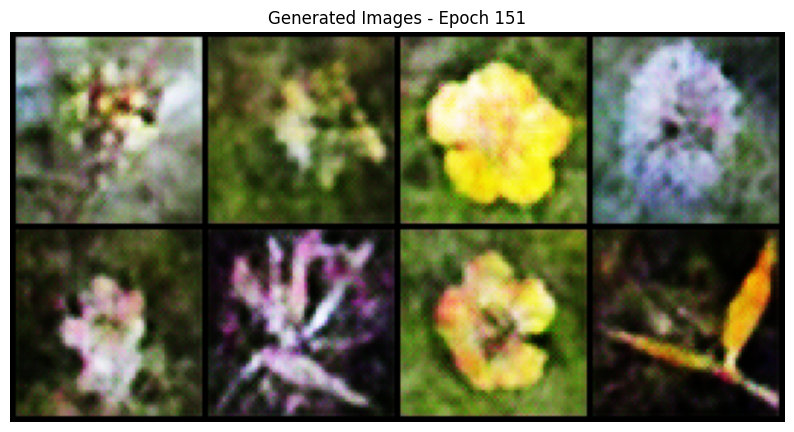

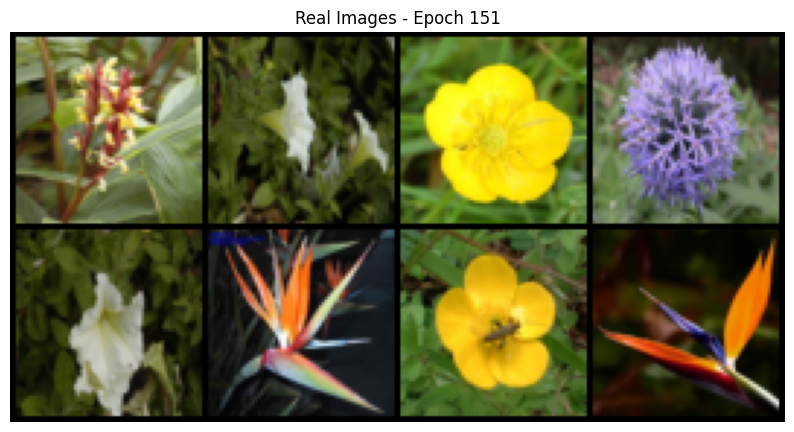

Epoch 152:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [152/200] D_loss: 1.4594 G_loss: 2.6303


Epoch 153:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [153/200] D_loss: 1.4641 G_loss: 2.6132


Epoch 154:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [154/200] D_loss: 1.4541 G_loss: 2.6110


Epoch 155:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [155/200] D_loss: 1.4494 G_loss: 2.5988


Epoch 156:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [156/200] D_loss: 1.4488 G_loss: 2.5853


Epoch 157:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [157/200] D_loss: 1.4505 G_loss: 2.5889


Epoch 158:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [158/200] D_loss: 1.4617 G_loss: 2.5741


Epoch 159:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [159/200] D_loss: 1.4483 G_loss: 2.5653


Epoch 160:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [160/200] D_loss: 1.4476 G_loss: 2.5515


Epoch 161:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [161/200] D_loss: 1.4442 G_loss: 2.5525


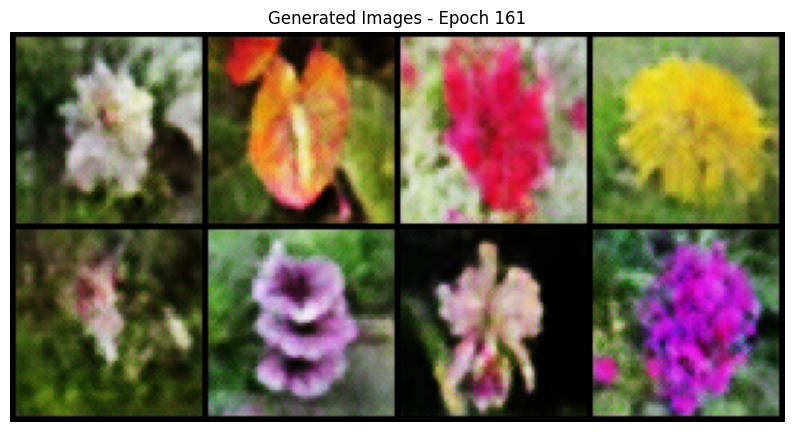

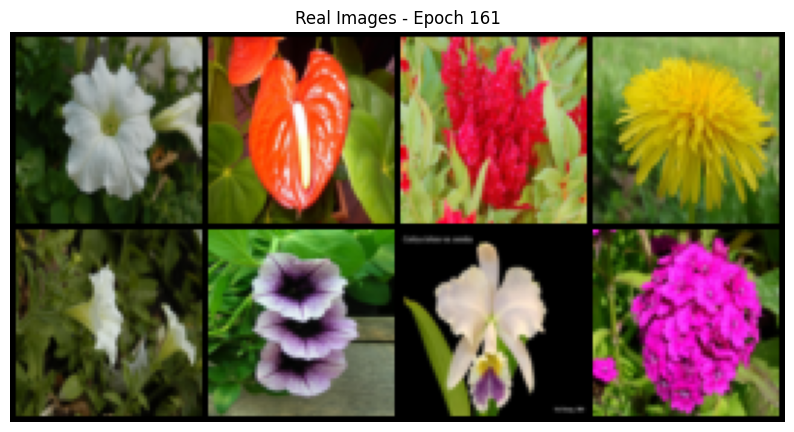

Epoch 162:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [162/200] D_loss: 1.4472 G_loss: 2.5393


Epoch 163:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [163/200] D_loss: 1.4442 G_loss: 2.5224


Epoch 164:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [164/200] D_loss: 1.4423 G_loss: 2.5169


Epoch 165:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [165/200] D_loss: 1.4510 G_loss: 2.5094


Epoch 166:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [166/200] D_loss: 1.4505 G_loss: 2.4941


Epoch 167:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [167/200] D_loss: 1.4497 G_loss: 2.4925


Epoch 168:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [168/200] D_loss: 1.4400 G_loss: 2.4910


Epoch 169:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [169/200] D_loss: 1.4423 G_loss: 2.4798


Epoch 170:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [170/200] D_loss: 1.4395 G_loss: 2.4776


Epoch 171:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [171/200] D_loss: 1.4408 G_loss: 2.4583


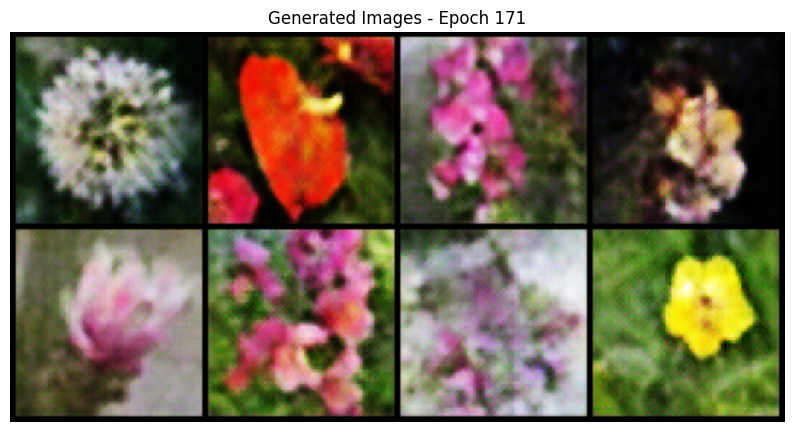

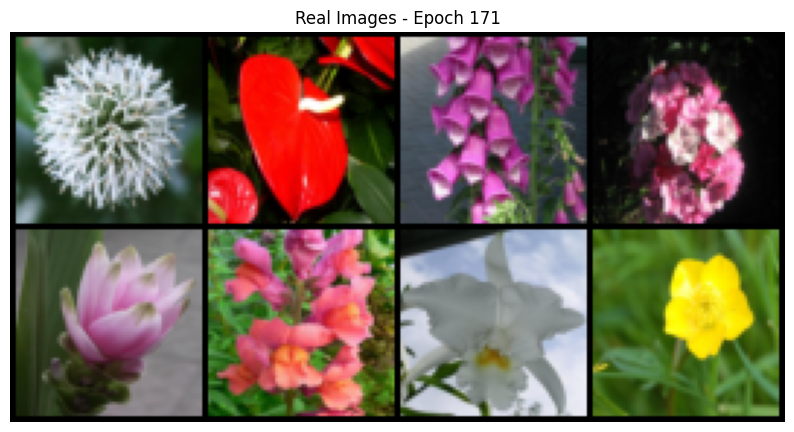

Epoch 172:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [172/200] D_loss: 1.4357 G_loss: 2.4583


Epoch 173:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [173/200] D_loss: 1.4476 G_loss: 2.4611


Epoch 174:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [174/200] D_loss: 1.4447 G_loss: 2.4512


Epoch 175:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [175/200] D_loss: 1.4342 G_loss: 2.4523


Epoch 176:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [176/200] D_loss: 1.4362 G_loss: 2.4465


Epoch 177:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [177/200] D_loss: 1.4358 G_loss: 2.4359


Epoch 178:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [178/200] D_loss: 1.4374 G_loss: 2.4236


Epoch 179:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [179/200] D_loss: 1.4369 G_loss: 2.4234


Epoch 180:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [180/200] D_loss: 1.4378 G_loss: 2.4068


Epoch 181:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [181/200] D_loss: 1.4312 G_loss: 2.3930


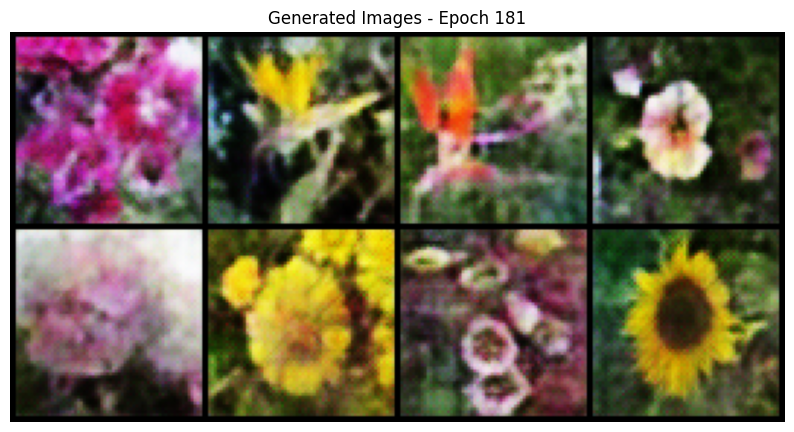

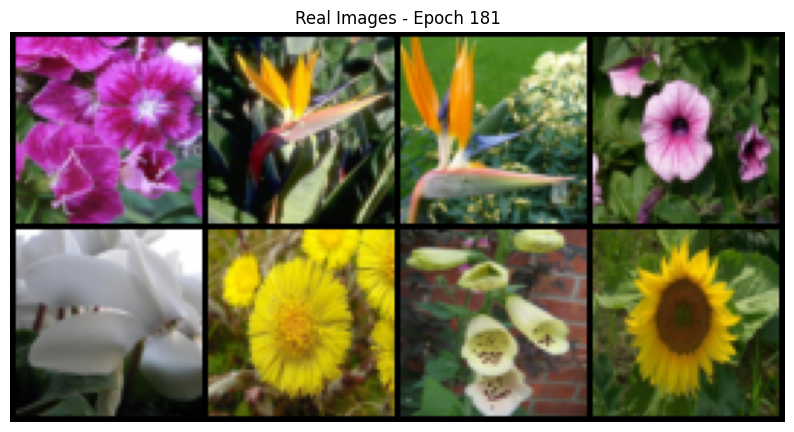

Epoch 182:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [182/200] D_loss: 1.4294 G_loss: 2.4166


Epoch 183:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [183/200] D_loss: 1.4356 G_loss: 2.4072


Epoch 184:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [184/200] D_loss: 1.4349 G_loss: 2.3995


Epoch 185:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [185/200] D_loss: 1.4317 G_loss: 2.3756


Epoch 186:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [186/200] D_loss: 1.4311 G_loss: 2.3672


Epoch 187:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [187/200] D_loss: 1.4388 G_loss: 2.3675


Epoch 188:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [188/200] D_loss: 1.4276 G_loss: 2.3558


Epoch 189:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [189/200] D_loss: 1.4309 G_loss: 2.3565


Epoch 190:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [190/200] D_loss: 1.4293 G_loss: 2.3495


Epoch 191:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [191/200] D_loss: 1.4297 G_loss: 2.3637


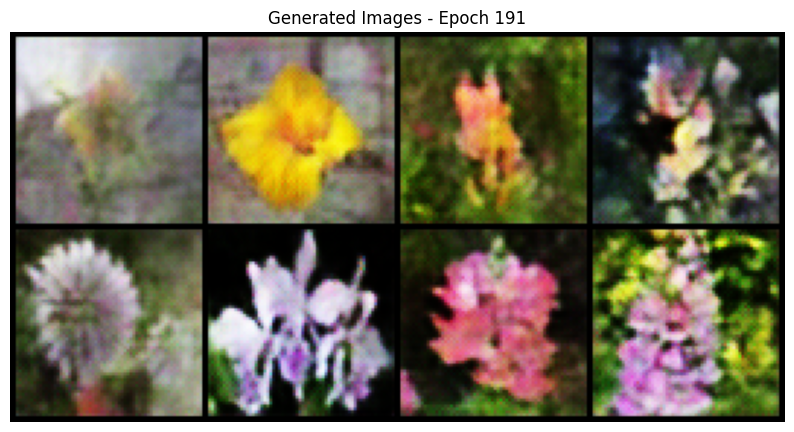

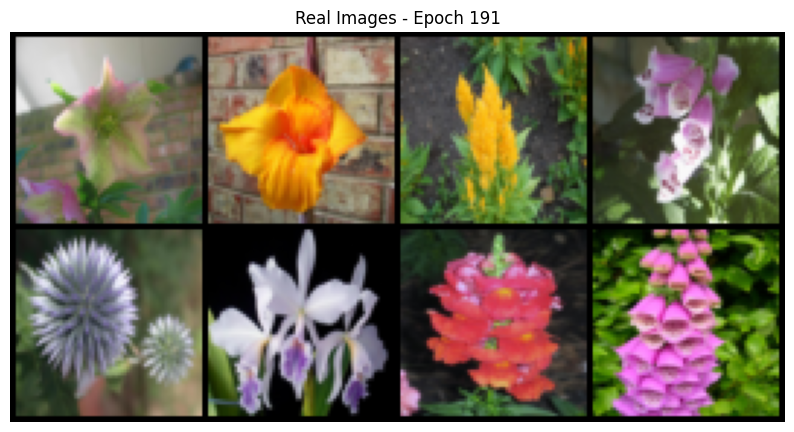

Epoch 192:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [192/200] D_loss: 1.4253 G_loss: 2.3612


Epoch 193:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [193/200] D_loss: 1.4289 G_loss: 2.3374


Epoch 194:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [194/200] D_loss: 1.4327 G_loss: 2.3333


Epoch 195:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [195/200] D_loss: 1.4275 G_loss: 2.3332


Epoch 196:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [196/200] D_loss: 1.4297 G_loss: 2.3228


Epoch 197:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [197/200] D_loss: 1.4268 G_loss: 2.3207


Epoch 198:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [198/200] D_loss: 1.4282 G_loss: 2.3334


Epoch 199:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [199/200] D_loss: 1.4327 G_loss: 2.3161


Epoch 200:   0%|          | 0/55 [00:00<?, ?it/s]

Epoch [200/200] D_loss: 1.4356 G_loss: 2.3110


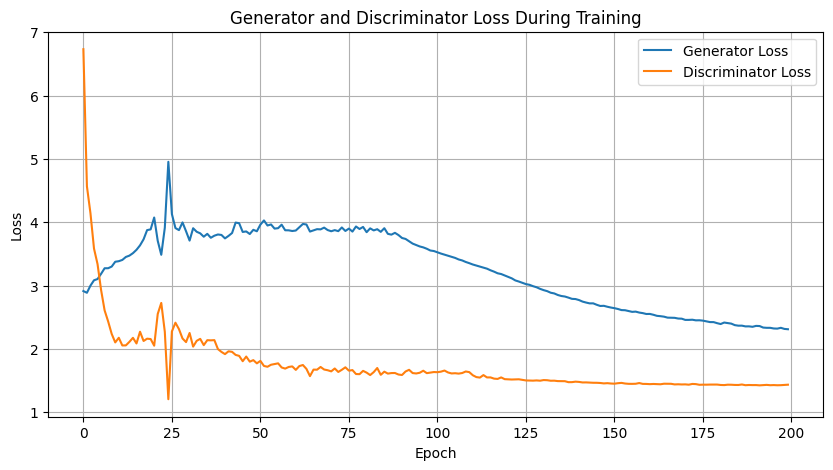

In [10]:
def plot_losses(g_losses, d_losses):
    plt.figure(figsize=(10, 5))
    plt.title("Generator and Discriminator Loss During Training")
    plt.plot(g_losses, label="Generator Loss")
    plt.plot(d_losses, label="Discriminator Loss")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()
    plt.grid(True)
    plt.show()


def show_images(images, num_images=8, figsize=(10, 10), title=None, activation="sigmoid"):
    if activation == 'tanh':
        images = (images + 1) / 2  
    elif activation == 'sigmoid':
        pass 
    images = torch.clamp(images, 0, 1)
    image_grid = make_grid(images[:num_images], nrow=4)
    image_grid = image_grid.cpu().detach().numpy().transpose((1, 2, 0))
    
    plt.figure(figsize=figsize)
    plt.imshow(image_grid)
    if title:
        plt.title(title)
    plt.axis('off')
    plt.show()

def train_step(real_images, text_embeddings, source_encoder, text_encoder, target_generator, discriminator, 
               g_optimizer, d_optimizer, perceptual_loss, lambda_gp=10.0):
    batch_size = real_images.size(0)
    device = real_images.device
    

    noise = torch.randn(batch_size, latent_dim, device=device)
    

    source_representation = source_encoder(real_images)
    text_encoding = text_encoder(text_embeddings)
    

    fake_images = target_generator(source_representation, text_encoding)
    
    real_labels = torch.ones(batch_size, 1, device=device) 
    fake_labels = torch.zeros(batch_size, 1, device=device)  
    

    d_optimizer.zero_grad()
    

    d_real_logits = discriminator(real_images, text_embeddings)
    d_real_loss = bce_loss(sigmoid(d_real_logits), real_labels) 
    

    d_fake_logits = discriminator(fake_images.detach(), text_embeddings)
    d_fake_loss = bce_loss(sigmoid(d_fake_logits), fake_labels)  
    
    alpha = torch.rand(batch_size, 1, 1, 1, device=device)
    interpolated_images = alpha * real_images + (1 - alpha) * fake_images.detach()
    interpolated_images.requires_grad_(True)
    d_interpolated = discriminator(interpolated_images, text_embeddings)
    
    gradients = torch.autograd.grad(
        outputs=d_interpolated,
        inputs=interpolated_images,
        grad_outputs=torch.ones_like(d_interpolated),
        create_graph=True,
        retain_graph=True
    )[0]
    gradients = gradients.view(batch_size, -1)
    gradient_penalty = ((gradients.norm(2, dim=1) - 1) ** 2).mean() * lambda_gp
    
    d_loss = d_real_loss + d_fake_loss + gradient_penalty
    d_loss.backward()
    d_optimizer.step()
    

    g_optimizer.zero_grad()
    
 
    g_fake_logits = discriminator(fake_images, text_embeddings)
    g_adv_loss = bce_loss(sigmoid(g_fake_logits), real_labels) 
    
    # Perceptual loss
    p_loss = perceptual_loss(fake_images, real_images)
    

    g_loss = g_adv_loss + 1.0 * p_loss 
    g_loss.backward()
    g_optimizer.step()
    
    return d_loss.item(), g_loss.item()


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
latent_dim = 200
text_embedding_dim = 1024

source_encoder = SourceEncoder(out_dim=256).to(device)
text_encoder = TextEncoder(text_embedding_dim=text_embedding_dim, out_dim=256).to(device)
target_generator = TargetGenerator(text_embedding_dim=text_embedding_dim, latent_dim=latent_dim, out_dim=256).to(device)
discriminator = Discriminator(text_embedding_dim=text_embedding_dim).to(device)

print(source_encoder.count_parameters())
print(target_generator.count_parameters())

g_optimizer = torch.optim.Adam(list(target_generator.parameters()) + list(text_encoder.parameters()), lr=0.00008, betas=(0.5, 0.999))
d_optimizer = torch.optim.Adam(discriminator.parameters(), lr=0.0001, betas=(0.5, 0.999))

perceptual_loss = PerceptualLoss().to(device)
bce_loss = nn.BCELoss()
sigmoid = nn.Sigmoid()

fixed_noise = torch.randn(8, latent_dim, device=device)
fixed_text_embeddings = None

g_losses_over_time = []
d_losses_over_time = []

num_epochs = 200
for epoch in range(num_epochs):
    total_d_loss = 0.0
    total_g_loss = 0.0
    batches = 0
    
    for real_images, text_embeddings, _ in tqdm(train_loader, desc=f'Epoch {epoch+1}'):
        real_images = real_images.to(device)
        text_embeddings = torch.mean(text_embeddings, dim=1).to(device)
        
        d_loss, g_loss = train_step(
            real_images, text_embeddings, 
            source_encoder, text_encoder, target_generator, discriminator,
            g_optimizer, d_optimizer, 
            perceptual_loss
        )
         
        total_d_loss += d_loss
        total_g_loss += g_loss
        batches += 1
    
    avg_d_loss = total_d_loss / batches
    avg_g_loss = total_g_loss / batches
    
    g_losses_over_time.append(avg_g_loss)
    d_losses_over_time.append(avg_d_loss)
    
    print(f"Epoch [{epoch+1}/{num_epochs}] D_loss: {avg_d_loss:.4f} G_loss: {avg_g_loss:.4f}")
     
    if fixed_text_embeddings is None:
        fixed_text_embeddings = text_embeddings[:8]
    
    if epoch % 10 == 0:
        with torch.no_grad():
            source_representation = source_encoder(real_images[:8])
            text_encoding = text_encoder(fixed_text_embeddings)
            fake_samples = target_generator(source_representation, text_encoding)
            show_images(fake_samples, title=f'Generated Images - Epoch {epoch+1}', activation='tanh')
            show_images(real_images[:8], title=f'Real Images - Epoch {epoch+1}', activation='tanh')
        
        target_generator.train()

plot_losses(g_losses_over_time, d_losses_over_time)

